## CIFAR-10

* 50,000개의 train example, 10,000개의 test example로 이루어져있다.
* 10개의 class를 가지고 있다.

### Label
| Label  | Description  |
|--------|--------------|
|   0    | airplane     |
|   1    | automobile   |
|   2    | bird         |
|   3    | cat          |
|   4    | deer         |
|   5    | dog          |
|   6    | frog         |
|   7    | horse        |
|   8    | ship         |
|   9    | truck        |

# 1. 데이터 준비하기

In [471]:
import os
import glob
import time

import PIL
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from IPython import display
from pathlib import Path
import matplotlib.pyplot as plt
%matplotlib inline

print("tensorflow", tf.__version__)

tensorflow 2.4.1


In [437]:
root_path = os.getenv('HOME')+'/aiffel/dcgan_newimage/cifar10/'

In [438]:
cifar10 = tf.keras.datasets.cifar10

# 이번 task에서는 label이 필요 없다.
(train_x, _), (test_x, _) = cifar10.load_data()

In [439]:
train_x.shape, test_x.shape

((50000, 32, 32, 3), (10000, 32, 32, 3))

위에서 살펴봤던대로 train은 5만장, test는 1만장을 가지고 있고, 이미지의 크기는 32x32이다.

In [440]:
train_x.max(), train_x.min()

(255, 0)

0\~255 픽셀 값을 가지고 있으므로 -1\~1로 정규화를 시켜준다.

In [441]:
train_x = (train_x-127.5) / 127.5
train_x.max(), train_x.min()

(1.0, -1.0)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

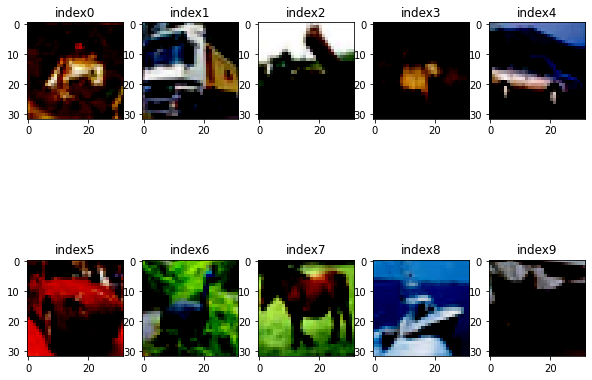

In [442]:
plt.figure(figsize=(10,8))
for idx in range(10):
    plt.subplot(2,5,idx+1)
    plt.imshow(train_x[idx])
    plt.title(f'index{idx}')        
  
plt.show()

In [443]:
BUFFER_SIZE = 50000
BATCH_SIZE = 256

In [444]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

# 2. generator 구현하기

In [445]:
def create_generator_model():
    model = tf.keras.Sequential()
    
    # First Layer
    model.add(layers.Dense(8*8*256, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Second Layer
    model.add(layers.Reshape((8,8,256)))
    
    # Third Layer
    model.add(layers.Conv2DTranspose(128,kernel_size=(5,5), strides=(1,1), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fourth Layer
    model.add(layers.Conv2DTranspose(64,kernel_size=(5,5), strides=(2,2), padding='same', use_bias=False))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Fifth
    model.add(layers.Conv2DTranspose(3, kernel_size=(5, 5), strides=(2, 2), padding='same', use_bias=False, \
                                     activation='tanh'))
    
    return model

### 왜 activation을 tanh로 했을까??
이미지를 정규화시켜 -1\~1로 맞췄기 때문에 데이터셋과 동일하게 맞추기 위해서 tanh를 썼다.

https://newly0513.tistory.com/20

In [446]:
generator = create_generator_model()
generator.summary()

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_19 (Dense)             (None, 16384)             1638400   
_________________________________________________________________
batch_normalization_29 (Batc (None, 16384)             65536     
_________________________________________________________________
leaky_re_lu_44 (LeakyReLU)   (None, 16384)             0         
_________________________________________________________________
reshape_10 (Reshape)         (None, 8, 8, 256)         0         
_________________________________________________________________
conv2d_transpose_27 (Conv2DT (None, 8, 8, 128)         819200    
_________________________________________________________________
batch_normalization_30 (Batc (None, 8, 8, 128)         512       
_________________________________________________________________
leaky_re_lu_45 (LeakyReLU)   (None, 8, 8, 128)       

In [447]:
# 랜덤 노이즈 벡터로 generator 확인
noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)
generated_image.shape

TensorShape([1, 32, 32, 3])

(32,32,3) 사이즈의 이미지가 생성되었다.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


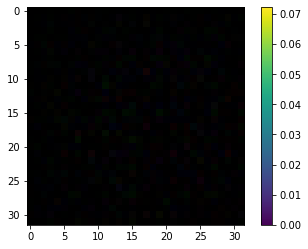

In [448]:
plt.imshow(generated_image[0, :, :, :])
plt.colorbar()
plt.show()

# 3. discriminator 구현하기

In [449]:
def create_discriminator_model():
    model = tf.keras.Sequential()
    
    # First Layer
    model.add(layers.Conv2D(64, (5,5), strides=(2,2), padding='same', input_shape=[32,32,3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Second Layer
    model.add(layers.Conv2D(128, (5,5), strides=(2,2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))
    
    # Third
    model.add(layers.Flatten())
    
    # Fourth
    model.add(layers.Dense(1))
    
    return model

In [450]:
discriminator = create_discriminator_model()
discriminator.summary()

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_16 (Conv2D)           (None, 16, 16, 64)        4864      
_________________________________________________________________
leaky_re_lu_47 (LeakyReLU)   (None, 16, 16, 64)        0         
_________________________________________________________________
dropout_16 (Dropout)         (None, 16, 16, 64)        0         
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 8, 8, 128)         204928    
_________________________________________________________________
leaky_re_lu_48 (LeakyReLU)   (None, 8, 8, 128)         0         
_________________________________________________________________
dropout_17 (Dropout)         (None, 8, 8, 128)         0         
_________________________________________________________________
flatten_8 (Flatten)          (None, 8192)            

In [451]:
decision = discriminator(generated_image, training=False)
decision

<tf.Tensor: shape=(1, 1), dtype=float32, numpy=array([[-0.0009625]], dtype=float32)>

# 4. Loss function, optimizer

## Loss function
GAN은 Loss function으로 Cross entropy를 사용한다.    

* generator: fake image에 대해 discriminator가 판별한 값이 1에 가까워져야 한다.(1: Real Image label)
* discriminator: real image에 대해 판별한 값은 1, fake image에 대해 판별한 값은 0에 가까워야 한다. (0: Fake Image label)    

cross_entropy를 활용해 loss를 계산할 때 `fake_output`, `real_output` 이 두 가지를 활용한다.
* `fake_output`: generator가 생성한 이미지를 discriminator가 입력받아 판별된 값. 
* `real_output`: real image를 discriminator에 입력시켜 판별된 값.

따라서 generator는 fake_output이 1에 가까워져야하고, discriminator는 real_output은 1에, fake_output은 0에 가까워져야 한다.

In [452]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [453]:
# generator_loss는 fake_output이 1에 가까워져야한다.
# 1에 가까워질 수록 cross_entropy값은 작은 값을 반환할 것이다.
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [454]:
# discriminator는 fake output은 0에 가까워져야하고,
# real output은 1에 가까워져야한다.
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss+fake_loss
    return total_loss

#### discriminator accuracy
real output과 fake output의 accuracy를 따로 계산해서 비교하는 것이 좋다.
이상적인 accuracy는 처음에는 real accuracy와 fake accuracy 둘 다 1.0이 나오지만 학습을 하면서 두 값이 모두 0.5로 떨어지는 경우이다.    
fake accuracy = 1 이면 generator에서 만든 이미지가 discriminator을 속이지 못하고 있는 것이다.

In [455]:
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(tf.math.greater_equal(real_output, tf.constant([0.5])), tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(tf.math.less(fake_output, tf.constant([0.5])), tf.float32))
    return real_accuracy, fake_accuracy

* `tf.math.greater_equal(real_output, tf.constant([0.5])` : real_output의 원소들이 0.5이상인지 판별
    결과는 True, False로 이루어져있지만 tf.cast에서 float32로 변환하고 있기 때문에 True는 1.0, False는 0.0이다.
    
    

## Optimizer
generator과 discriminator는 따로 진행하는 네트워크이기 때문에 optimizer도 두개를 만들어줘야 한다.

In [456]:
generator_optimizer = tf.keras.optimizers.Adam(1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4)

In [457]:
# 고정된 seed 노이즈
noise_dim = 100
num_examples_to_generate = 16

seed = tf.random.normal([num_examples_to_generate, noise_dim])
seed.shape

TensorShape([16, 100])

# 5. 훈련과정 설계

In [458]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        
        gen_loss=generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)
        
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output)
        
    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    return gen_loss, disc_loss, real_accuracy, fake_accuracy

* `tf.GradientTape()`: gradient를 자동 미분

### 샘플을 생성하는 함수

In [459]:
def generate_and_save_images(epoch_path, model, epoch, it, sample_seeds):
    # normalization 푸는
    predictions = model(sample_seeds, training=False)
    
    np_generated = predictions.numpy()
    np_generated = (np_generated * 127.5) + 127.5   # reverse of normalization
    np_generated = np_generated.astype(int)

    fig=plt.figure(figsize=(4,4))
    for i in range(np_generated.shape[0]):
        plt.subplot(4,4,i+1)
        plt.imshow(np_generated[i, :, :, :])
        plt.axis('off')
    try: 
        Path(f'{epoch_path}/generated_samples').mkdir(parents=True, exist_ok=True)
        plt.savefig('{}/generated_samples/sample_epoch_{:04d}_iter_{:03d}.png'.format(epoch_path, epoch, it))
    finally:
        plt.show()

### loss와 accuracy 시각화하는 함수

In [460]:
from matplotlib.pylab import rcParams

rcParams['figure.figsize'] = 15, 8
def train_history_visualization(epoch_path, history, epoch):
    # summary loss
    plt.subplot(211)  
    plt.plot(history['gen_loss'])  
    plt.plot(history['disc_loss'])  
    plt.title('model loss')  
    plt.ylabel('loss')  
    plt.xlabel('batch iters')  
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')
    
    # summary accuracy
    plt.subplot(212)  
    plt.plot(history['fake_accuracy'])  
    plt.plot(history['real_accuracy'])  
    plt.title('discriminator accuracy')  
    plt.ylabel('accuracy')  
    plt.xlabel('batch iters')  
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')  
    
    Path(f'{epoch_path}/training_history').mkdir(parents=True, exist_ok=True)
    # epoch별 그래프를 이미지로 저장
    plt.savefig('{}/training_history/train_history_{:04d}.png'
                    .format(epoch_path, epoch))
    plt.show()

### Checkpoint 만들기
checkpoint에 optimizer와 generator, discriminator을 전부 저장한다.

In [461]:
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

# 6. Model training 

In [462]:
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}
    epoch_path= root_path+f'/Epoch{str(epochs)}'
    Path(epoch_path).mkdir(parents=True, exist_ok=True)
        
    checkpoint_dir = epoch_path+'/training_checkpoints'
    Path(checkpoint_dir).mkdir(parents=True, exist_ok=True)
    checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                display.clear_output(wait=True)
                generate_and_save_images(epoch_path, generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        
        
        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        display.clear_output(wait=True)
        generate_and_save_images(epoch_path, generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        train_history_visualization(epoch_path, history, epoch)

In [463]:
save_every = 5
EPOCHS = 50

# 사용가능한 GPU 디바이스 확인
tf.config.list_physical_devices("GPU")

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

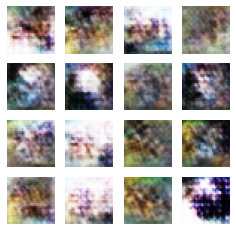

Time for training : 1500 sec


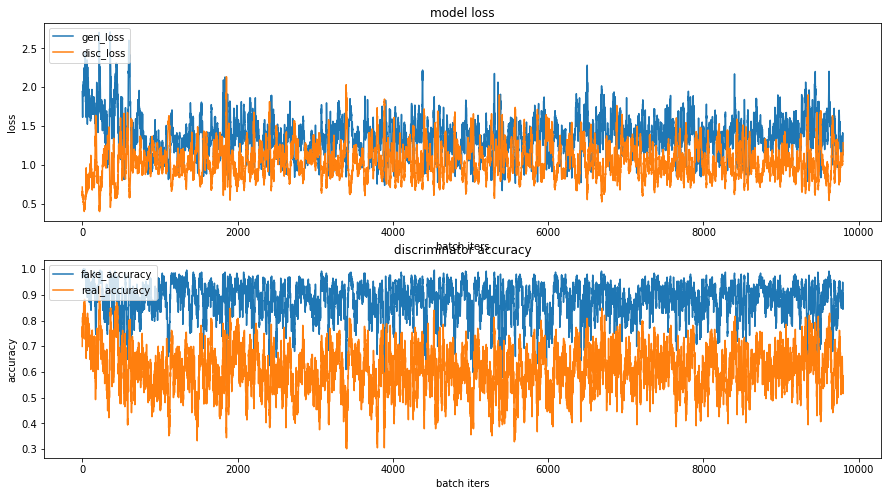

CPU times: user 24min 59s, sys: 24.2 s, total: 25min 23s
Wall time: 25min 1s


In [338]:
%%time
train(train_dataset, EPOCHS, save_every)

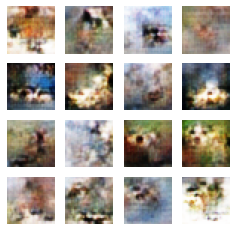

Time for training : 3022 sec


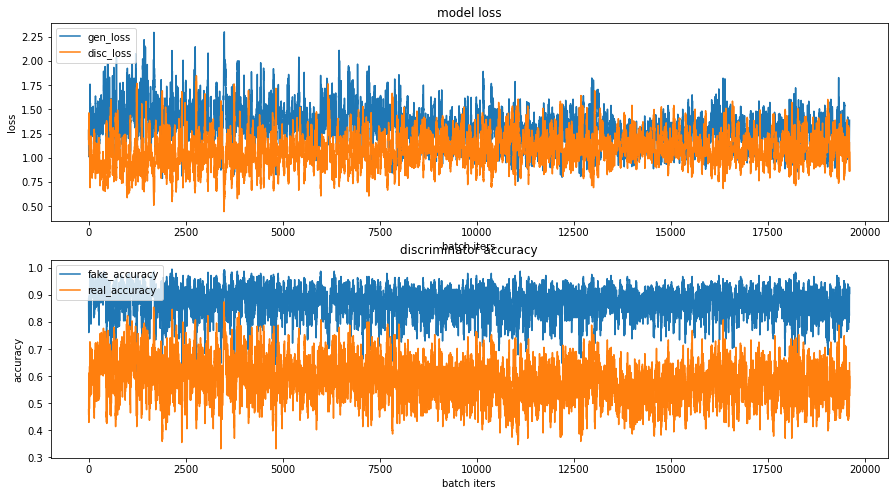

In [339]:
EPOCHS = 100
train(train_dataset, EPOCHS, save_every)

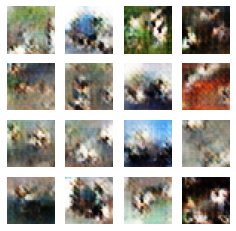

Time for training : 6064 sec


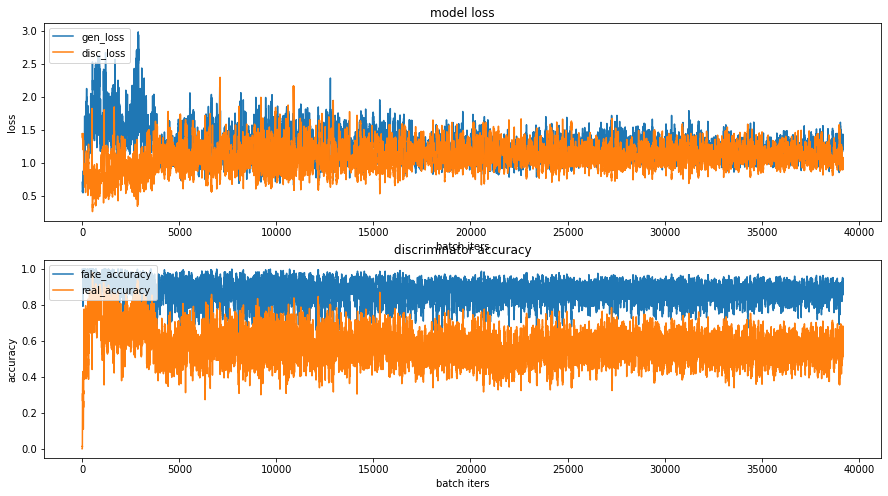

In [464]:
EPOCHS = 200
train(train_dataset, EPOCHS, save_every)

# 7. 시각화

In [467]:
def make_generate_image_gif(epoch):
    epoch_path = root_path+f'Epoch{epoch}'
    anim_file = epoch_path+'/cifar10_dcgan.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/generated_samples/sample*.png'.format(epoch_path))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)
    return anim_file

In [468]:
def make_history_image_gif(epoch):
    epoch_path = root_path+f'Epoch{epoch}'
    anim_file = epoch_path+'/cifar10_history.gif'

    with imageio.get_writer(anim_file, mode='I') as writer:
        filenames = glob.glob('{}/training_history/train_history_*.png'.format(epoch_path))
        filenames = sorted(filenames)
        last = -1
        for i, filename in enumerate(filenames):
            frame = 2*(i**0.5)
            if round(frame) > round(last):
                last = frame
            else:
                continue
            image = imageio.imread(filename)
            writer.append_data(image)
        image = imageio.imread(filename)
        writer.append_data(image)
    return anim_file

### Epoch 50

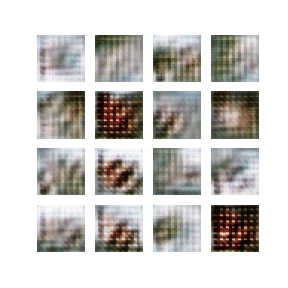

In [475]:
from IPython.display import Image as Img

dcgan_image_path = make_generate_image_gif(50)
gif = Img(dcgan_image_path)
gif

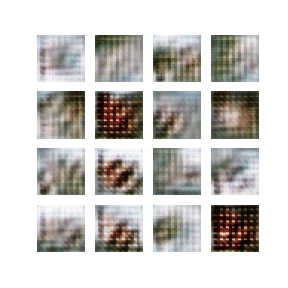

In [519]:
from IPython.display import Image
with open('cifar10_dcgan_50.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

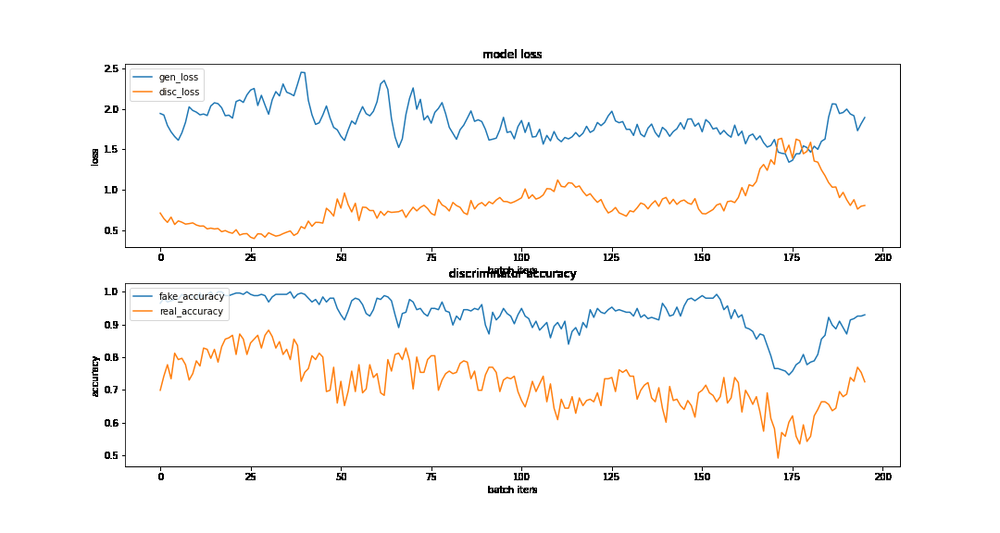

In [476]:
history_image_path = make_history_image_gif(50)
gif = Img(history_image_path)
gif

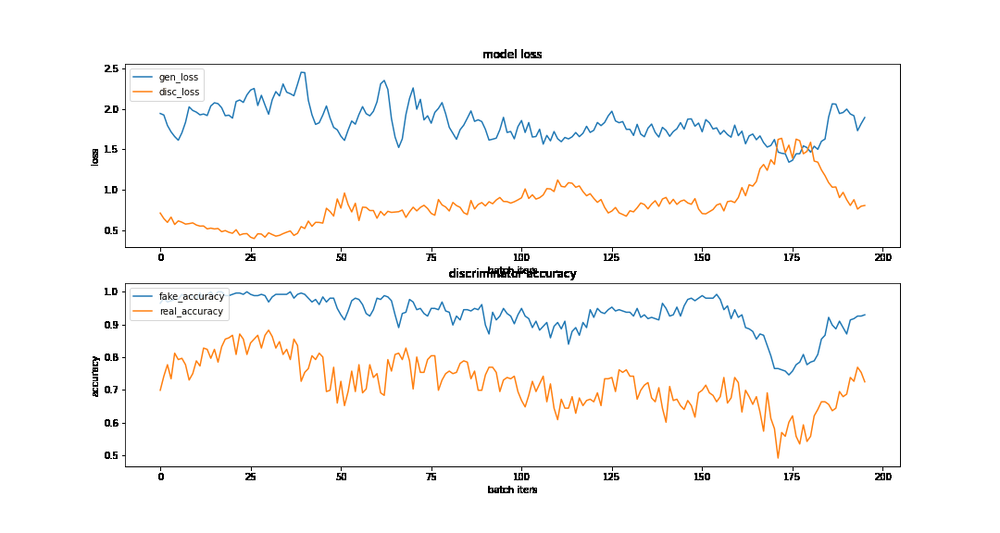

In [520]:
with open('cifar10_history_50.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

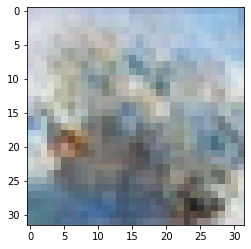

In [477]:
checkpoint_dir = root_path+f'Epoch50'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5 
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  

정체불명의 이미지가 생성되었다.

### Epoch 100

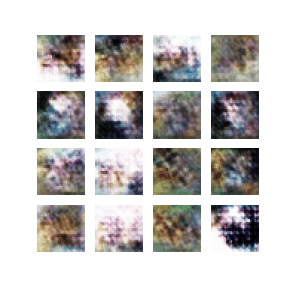

In [478]:
dcgan_image_path = make_generate_image_gif(100)
gif = Img(dcgan_image_path)
display(gif)

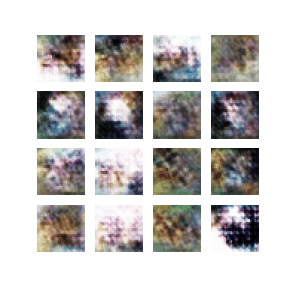

In [521]:
with open('cifar10_dcgan_100.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

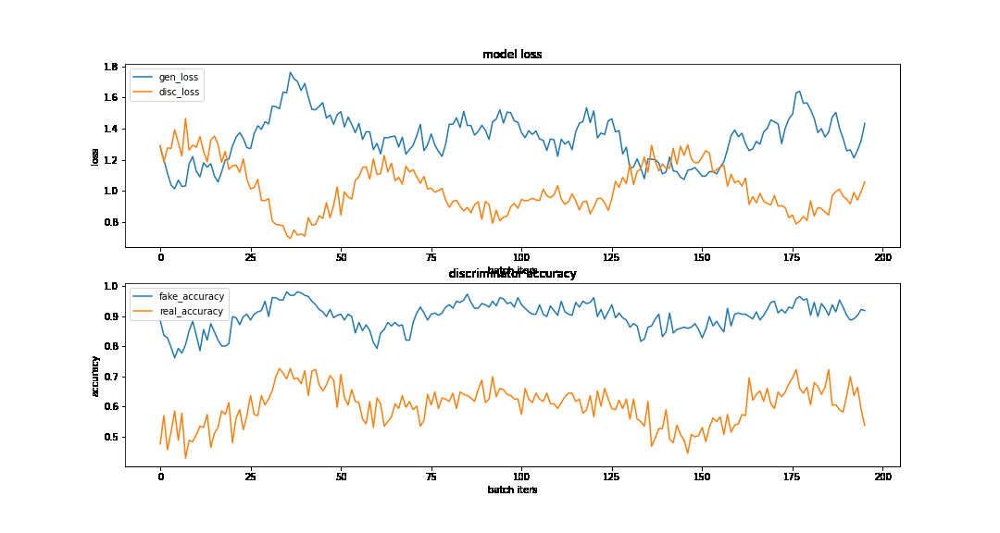

In [479]:
history_image_path = make_history_image_gif(100)
gif = Img(history_image_path)
gif

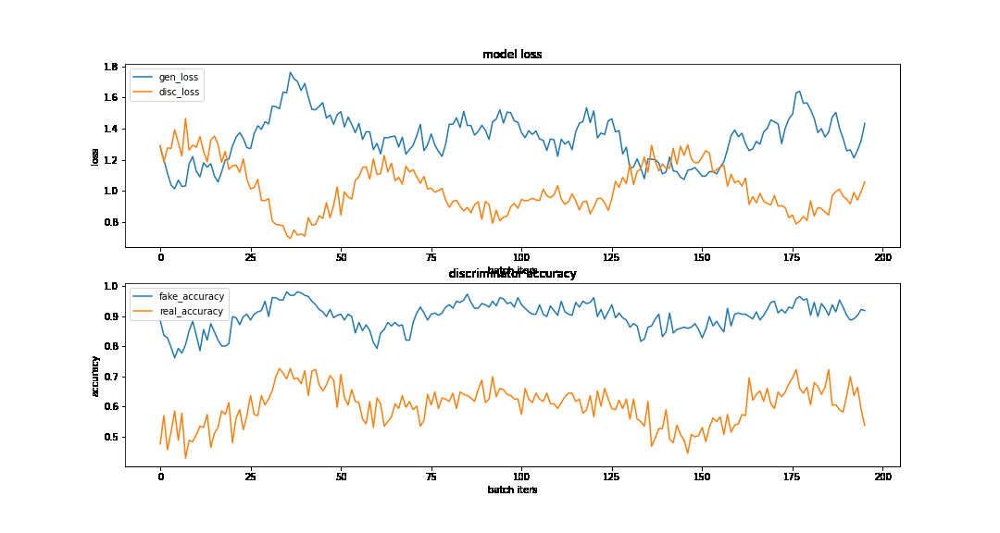

In [522]:
with open('cifar10_history_100.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

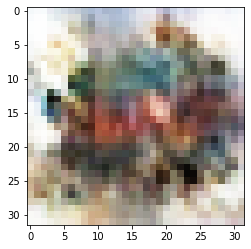

In [480]:
checkpoint_dir = root_path+f'Epoch100'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5 
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  

Epoch50보다는 나아졌지만 여전히 형태를 알아보기 어려운 이미지가 생성되었다.    
자동차같기도 하고...

### Epoch 200

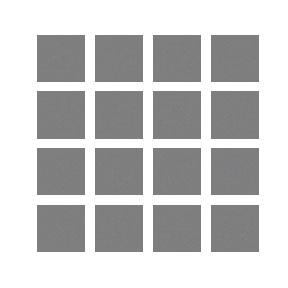

In [523]:
dcgan_image_path = make_generate_image_gif(200)
gif = Img(dcgan_image_path)
gif

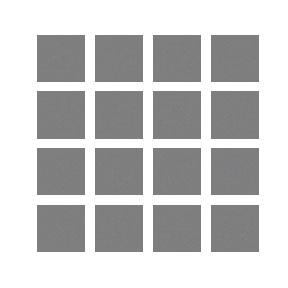

In [525]:
with open('cifar10_dcgan_200.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

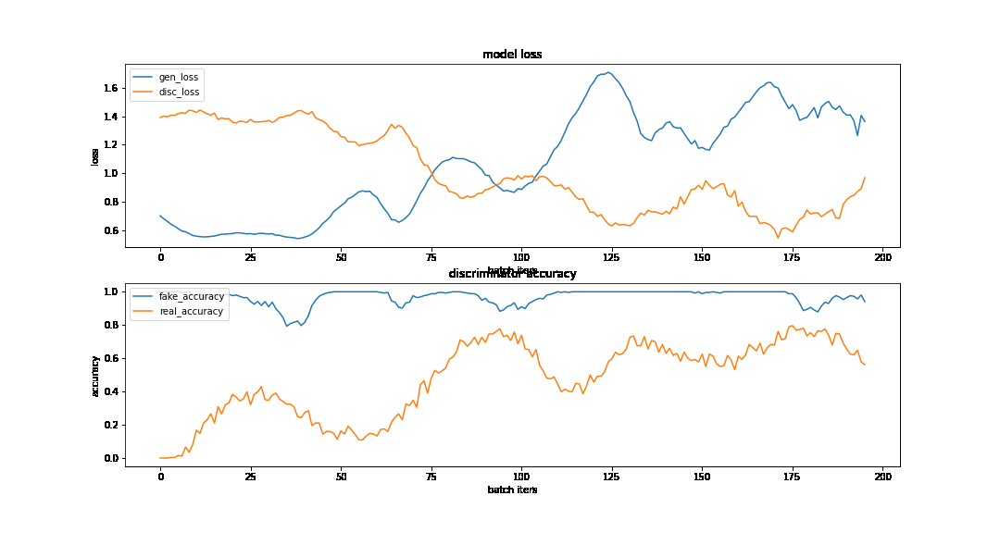

In [482]:
history_image_path = make_history_image_gif(200)
gif = Img(history_image_path)
gif

In [ ]:
with open('cifar10_history_200.gif','rb') as f:
    gif = Img(data=f.read(), format='png')
    
gif

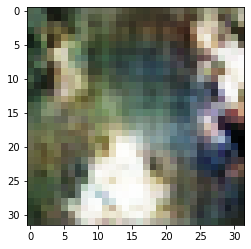

In [502]:
checkpoint_dir = root_path+f'Epoch200'

latest = tf.train.latest_checkpoint(checkpoint_dir)
checkpoint.restore(latest)

generator = checkpoint.generator
discriminator = checkpoint.discriminator

noise = tf.random.normal([1, 100])
generated_image = generator(noise, training=False)

np_generated = generated_image.numpy()
np_generated = (np_generated * 127.5) + 127.5 
np_generated = np_generated.astype(int)
plt.imshow(np_generated[0])
plt.show()  

Epoch을 높이면 더 나은 이미지를 생성할거라 예상했는데 Epoch 100보다도 더 안좋게 나온 것 같다.

# 회고

## 1️⃣ 아쉬웠던 점
* 모델을 개선하는 것을 못해봤다.
* 생성된 이미지도 잘 안만들어진 것 같아서 아쉬웠다.

## 2️⃣ 배운 점
* gif을 jupyter notebook에 올리는 방법을 배웠다.
* DCGAN을 필사하고, 구동 원리를 배웠다.

## 3️⃣ 시도한 것들
* 에폭을 50, 100, 200으로 증가시키면서 모델을 학습시켰다. 

## 4️⃣ 다짐
* 다른 분들 보니까 epoch500도 돌리시는데 좀 더 실험을 해봐야겠다고 생각했다.
* 미루지 말고 미리 시작해서 다양한 시도를 해보자.

#  Reference
* https://newly0513.tistory.com/20
* https://kangbk0120.github.io/articles/2017-08/dcgan-pytorch